In [ ]:
%pip install ultralytics -q

In [19]:
#Let's do our imports

from ultralytics import YOLO
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import json
from sklearn.model_selection import train_test_split
from tqdm.auto import tqdm
import shutil
from PIL import Image

In [12]:
# Making our dataset ready for the Yolo
base_dir = Path('C:/Users/dodge/Desktop/Marchegiani/Progetto/Dataset/')
img_path = base_dir / 'data_object_image_2_unzipped' / 'training' / 'image_2'
label_path = Path('C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti_dataset_yolo_format/labels')
with open('C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti_dataset_yolo_format/classes.json','r') as f:
    classes = json.load(f)

classes

{'Car': 0,
 'Pedestrian': 1,
 'Van': 2,
 'Cyclist': 3,
 'Truck': 4,
 'Misc': 5,
 'Tram': 6,
 'Person_sitting': 7}

In [13]:
# Just to visualize our actual pathes
ims = sorted(list(img_path.glob('*')))
labels = sorted(list(label_path.glob('*')))
pairs = list(zip(ims,labels))
pairs[:2]

[(WindowsPath('C:/Users/dodge/Desktop/Marchegiani/Progetto/Dataset/data_object_image_2_unzipped/training/image_2/000000.png'),
  WindowsPath('C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti_dataset_yolo_format_unzipped/labels/000000.txt')),
 (WindowsPath('C:/Users/dodge/Desktop/Marchegiani/Progetto/Dataset/data_object_image_2_unzipped/training/image_2/000001.png'),
  WindowsPath('C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti_dataset_yolo_format_unzipped/labels/000001.txt'))]

In [14]:
# Let's split the validation set from the training set
train, test = train_test_split(pairs,test_size=0.1,shuffle=True)
len(train), len(test)

(6732, 749)

In [15]:
train_path = Path('train').resolve()
train_path.mkdir(exist_ok=True)
valid_path = Path('valid').resolve()
valid_path.mkdir(exist_ok=True)

In [16]:
# For the training set
for t_img, t_lb in tqdm(train):
    im_path = train_path / t_img.name
    lb_path = train_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/6732 [00:00<?, ?it/s]

In [17]:
# For the validation set
for t_img, t_lb in tqdm(test):
    im_path = valid_path / t_img.name
    lb_path = valid_path / t_lb.name
    shutil.copy(t_img,im_path)
    shutil.copy(t_lb,lb_path)

  0%|          | 0/749 [00:00<?, ?it/s]

In [8]:
# Creating the YAML file
yaml_file = 'names:\n'
yaml_file += '\n'.join(f'- {c}' for c in classes)
yaml_file += f'\nnc: {len(classes)}'
yaml_file += f'\ntrain: {str(train_path)}\nval: {str(valid_path)}'
with open('kitti.yaml','w') as f:
    f.write(yaml_file)

In [21]:
# Let's import the model
model = YOLO('yolov8n.yaml')
model = YOLO('yolov8n.pt')



                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

In [23]:
# Let's start training
train_results = model.train(
    data='C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti.yaml', 
    epochs=10,
    patience=3,
    mixup=0.1,
    project='yolov8n-kitti',
    device='cpu'
)

New https://pypi.org/project/ultralytics/8.0.200 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.199  Python-3.9.13 torch-2.0.1+cpu CPU (Intel Core(TM) i7-6700HQ 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/kitti.yaml, epochs=10, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=yolov8n-kitti, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=Fals

In [24]:
#Validation phase
valid_results = model.val()

Ultralytics YOLOv8.0.199  Python-3.9.13 torch-2.0.1+cpu CPU (Intel Core(TM) i7-6700HQ 2.60GHz)
Model summary (fused): 168 layers, 3007208 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning C:\Users\dodge\Desktop\Marchegiani\Progetto\Progetto3D\valid.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [01:02<00:00,  1.32s/it]
                   all        749       4050      0.825      0.616       0.72      0.473
                   Car        749       3002      0.937      0.762        0.9      0.666
            Pedestrian        749        386      0.892      0.523      0.681      0.391
                   Van        749        271      0.838      0.686      0.796      0.561
               Cyclist        749        153       0.87      0.525      0.696      0.383
                 Truck        749        103      0.861      0.842      0.911  

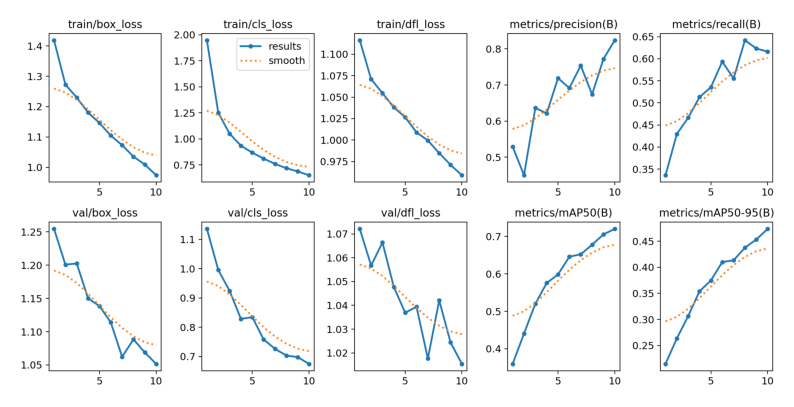

In [2]:
# Showing some results
plt.figure(figsize=(10,20))
plt.imshow(Image.open('C:/Users/dodge/Desktop/Marchegiani/Progetto/Progetto3D/yolov8n-kitti/train3/results.png'))
plt.axis('off')
plt.show()

In [44]:
# Let's see some predictions
preds = model.predict([test[idx][0] for idx in np.random.randint(0,len(test),(20,))],save=True)


0: 640x640 5 cars, 1: 640x640 1 car, 2: 640x640 9 cars, 3: 640x640 13 cars, 4: 640x640 4 cars, 1 truck, 5: 640x640 4 cars, 1 truck, 6: 640x640 4 cars, 1 truck, 7: 640x640 1 person, 8 cars, 8: 640x640 1 person, 1 car, 9: 640x640 2 cars, 1 truck, 10: 640x640 1 car, 1 train, 11: 640x640 2 cars, 12: 640x640 5 cars, 13: 640x640 4 cars, 1 traffic light, 14: 640x640 7 cars, 15: 640x640 11 cars, 16: 640x640 1 person, 3 cars, 17: 640x640 1 person, 18: 640x640 4 cars, 1 bus, 1 truck, 19: 640x640 5 cars, 1 bus, 1 train, 3687.1ms
Speed: 4.6ms preprocess, 184.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs\detect\predict2


In [45]:
preds = list(Path('runs/detect/predict2').glob('*'))

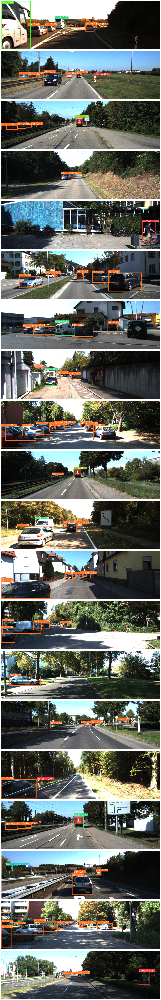

In [46]:
def plot_images(images):
    num_images = len(images)
    rows = num_images
    cols = 1
    fig, axes = plt.subplots(rows, cols, figsize=(15, 80))
    for ax in axes.flat:
        ax.axis('off')
    for i, img_path in enumerate(images):
        img = Image.open(img_path)
        axes[i].imshow(img)
    
    plt.tight_layout()
    plt.show()
    
plot_images(preds)